In [4]:
import os
import sys
import numpy as np

import torch
import matplotlib.pyplot as plt     # type: ignore
import PIL

sys.path.append('/user_data/mmhender/featsynth/texture_synthesis/code/')
import utilities

things_stim_path = '/user_data/mmhender/stimuli/things/'
save_stim_path1 = '/user_data/mmhender/stimuli/featsynth/images_v2'

ecoset_path = '/lab_data/tarrlab/common/datasets/Ecoset/'

ecoset_info_path = '/user_data/mmhender/stimuli/ecoset_info/'

In [10]:
fn = os.path.join(ecoset_info_path, 'categ_use_ecoset.npy')
info = np.load(fn, allow_pickle=True).item()
basic_names = list(info['binfo'].keys())
super_names = list(info['sinfo'].keys())

n_basic_each_super = len(info['sinfo'][super_names[0]]['basic_names'])
    
pix_thresh = 256;
    

In [5]:
# list of all files in each category
fn = os.path.join(ecoset_info_path, 'ecoset_file_info.npy')
efiles = np.load(fn, allow_pickle=True).item()



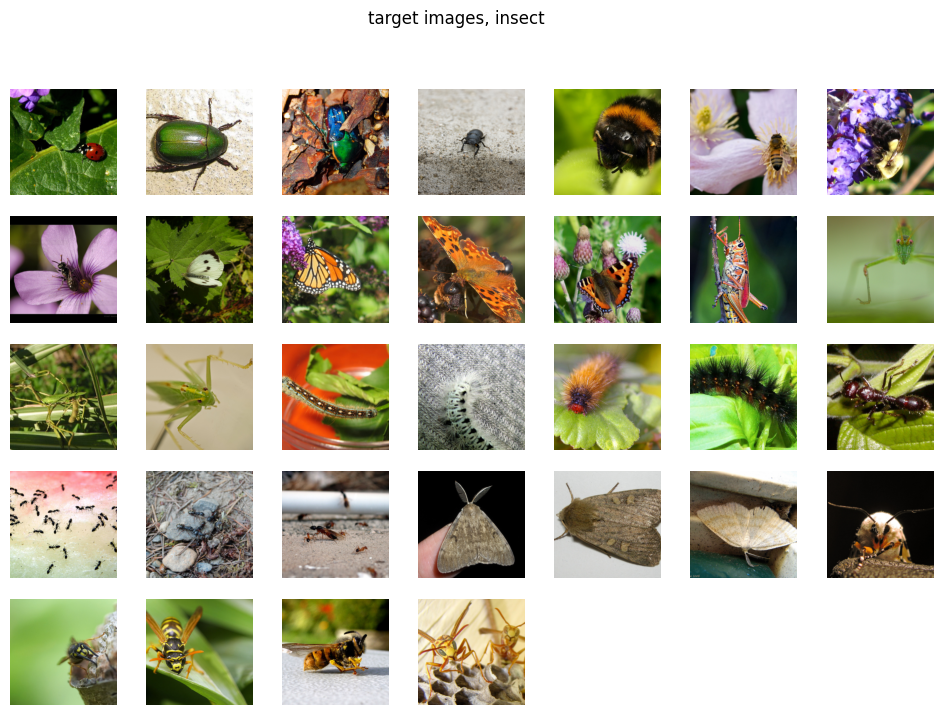

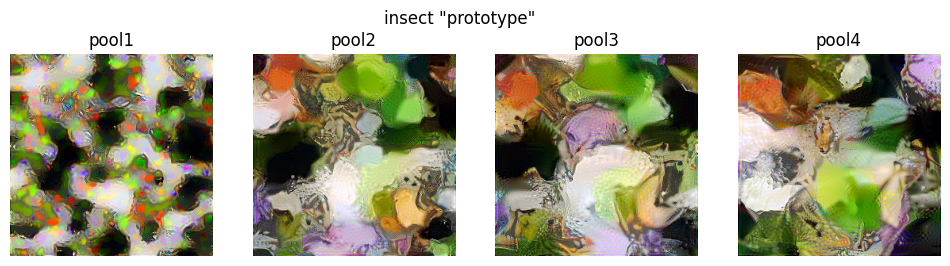

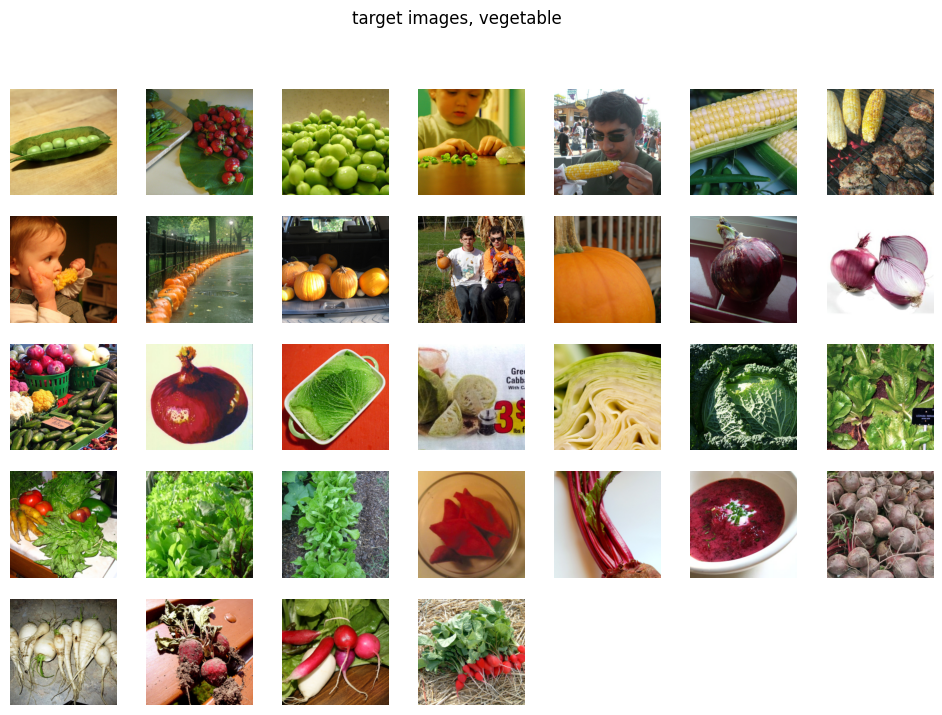

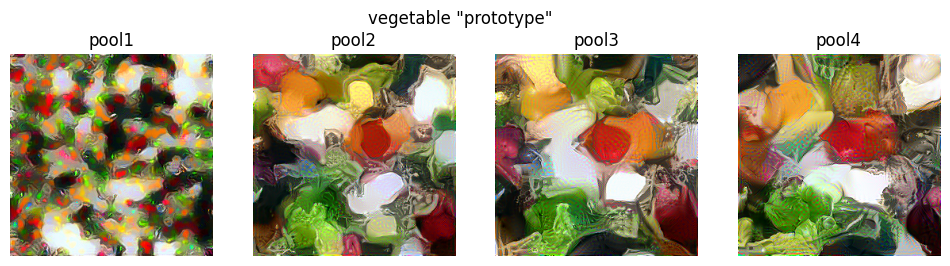

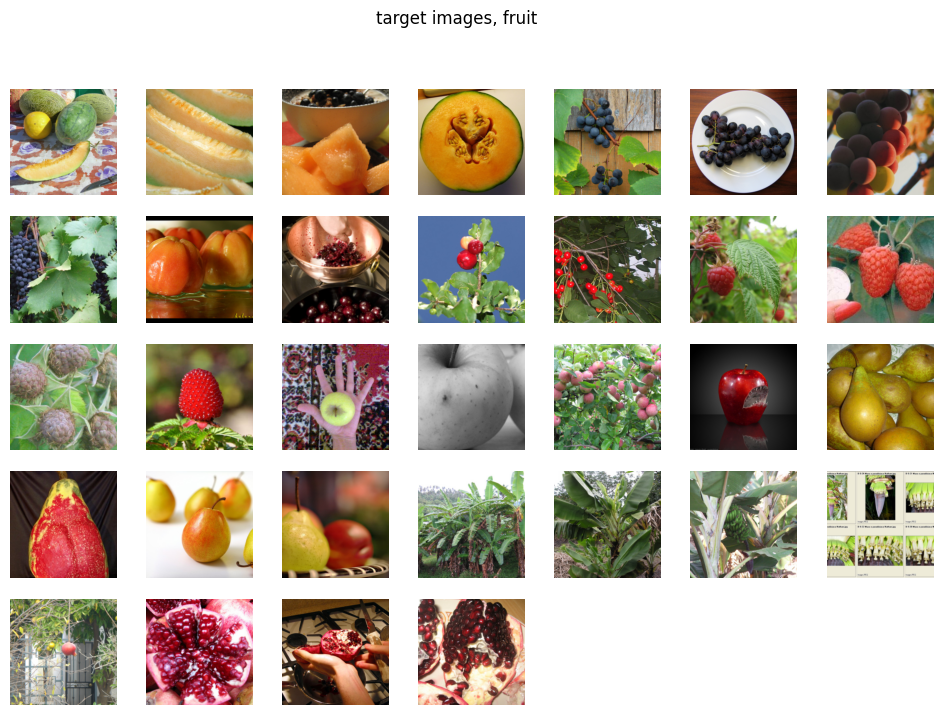

...

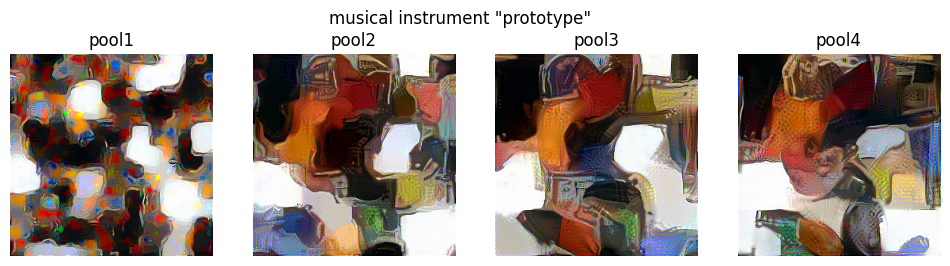

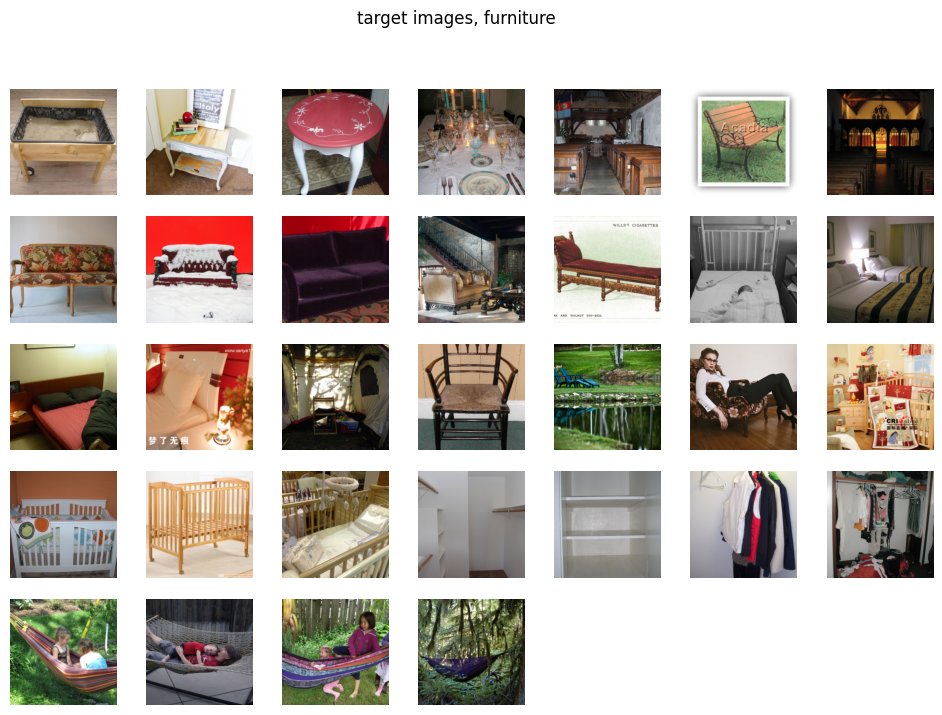

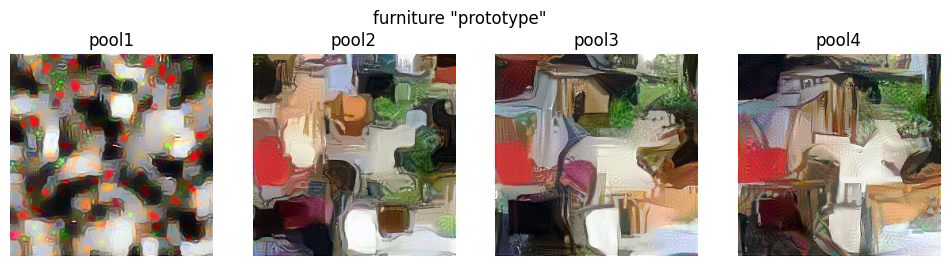

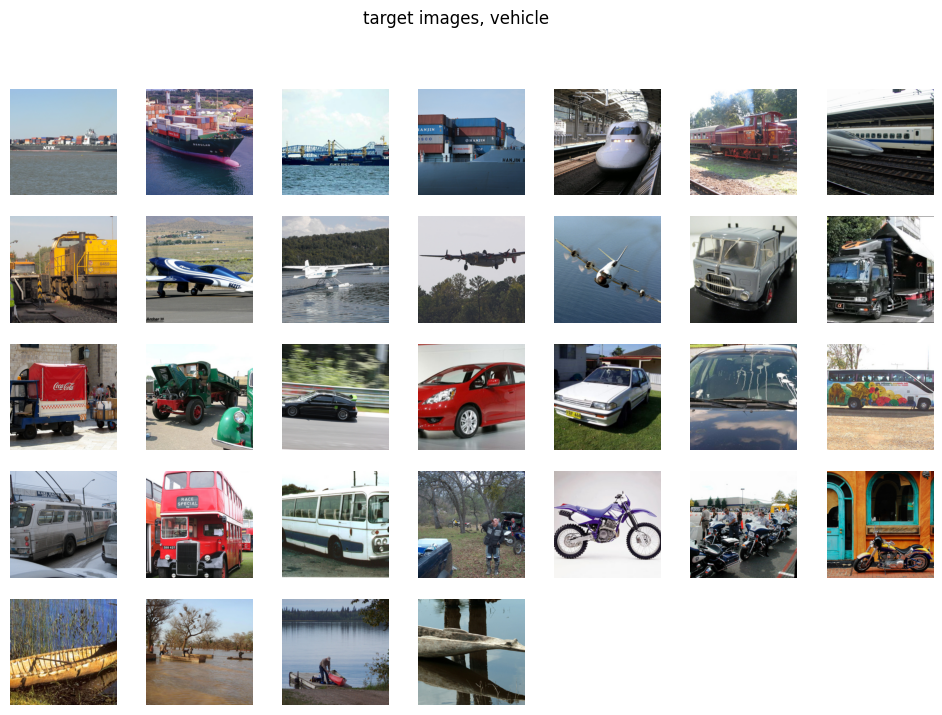

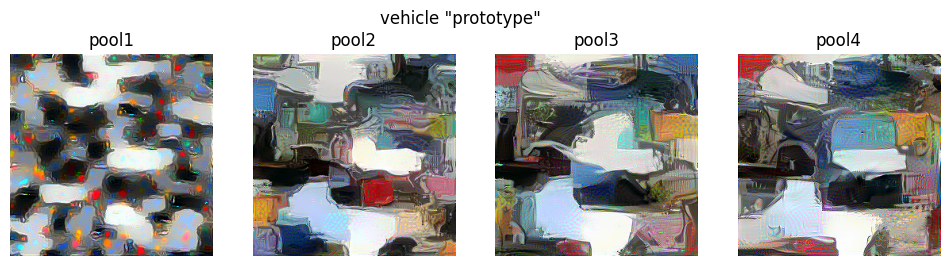

In [19]:
stim_path = '/user_data/mmhender/stimuli/featsynth/images_v2_superord_prototypes'

n_ims_combine = 32
n_ims_per_basic = int(np.ceil(n_ims_combine/n_basic_each_super))

for si in np.arange(8):
    
    sname = super_names[si]
    
    # choose images to analyze here
    target_image_filenames = []
    bnames = info['sinfo'][sname]['basic_names']
    for bi, bname in enumerate(bnames):

        folder = os.path.join(ecoset_path, 'train', info['binfo'][bname]['ecoset_folder'])
        imfiles_all = efiles[bname]['train']['images']
        sizes = efiles[bname]['train']['size']
        abv_thresh = np.array([(s1>=pix_thresh) & (s2>=pix_thresh) for s1, s2 in sizes])
        is_rgb = np.array(efiles[bname]['train']['mode'])=='RGB'
        ims_use_all = np.where(abv_thresh & is_rgb)[0]

        np.random.seed(123445+si+bi)
        ims_use = np.random.choice(ims_use_all, n_ims_per_basic, replace=False)

        target_image_filenames += [os.path.join(folder, imfiles_all[im]) for im in ims_use]

    plt.figure(figsize=(12,8))

    for ii, filename in enumerate(target_image_filenames):
       
        im = utilities.preprocess_image_tosave(
                utilities.load_image(filename)
            )
        # im = PIL.Image.open(target_image_filename)

        plt.subplot(5,7, ii+1)

        plt.imshow(im)
        plt.axis('off')

    plt.suptitle('target images, %s'%(sname));

    plt.figure(figsize=(12,3))

    out_dir = os.path.join(stim_path, '%s_prototype_%dims'%(sname, n_ims_combine))
    layers_plot = ['pool1','pool2','pool3','pool4']

    for ll in range(4):

        plt.subplot(1,4,ll+1)
        fn = os.path.join(out_dir, 'scramble_upto_%s.png'%(layers_plot[ll]))
        im = PIL.Image.open(fn)
        plt.imshow(im)
        plt.axis('off')
        plt.title('%s'%(layers_plot[ll]))

    plt.suptitle('%s "prototype"'%(sname));

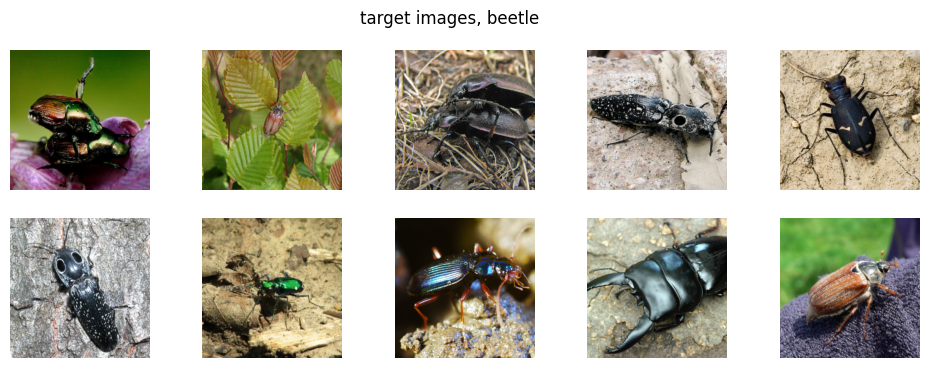

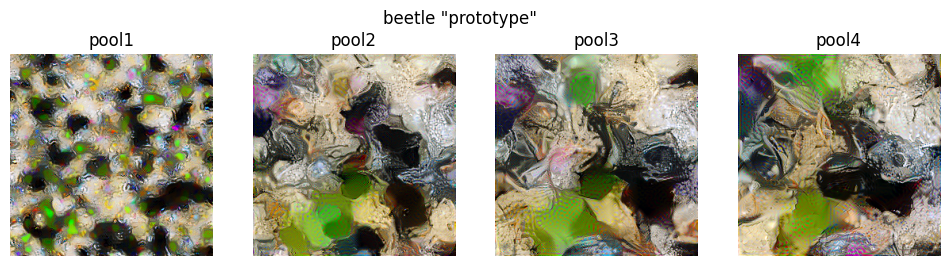

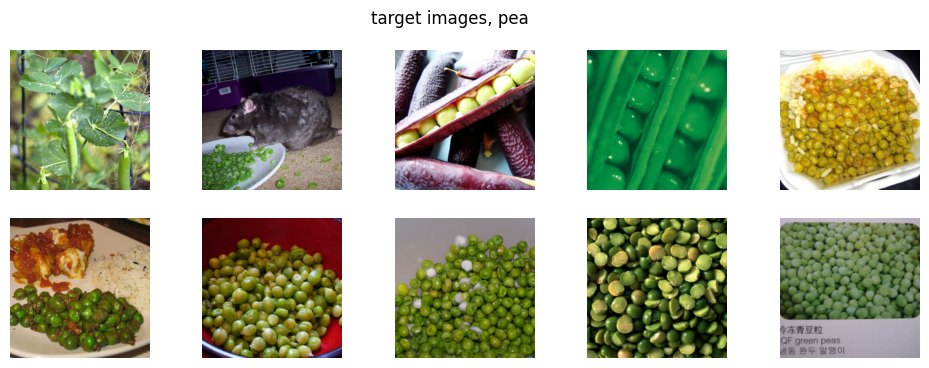

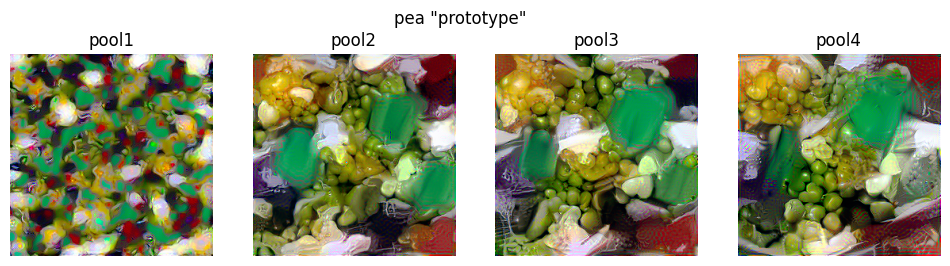

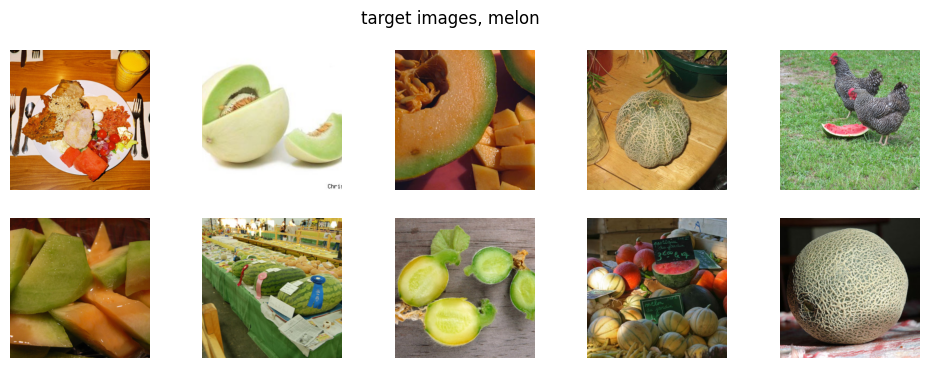

...

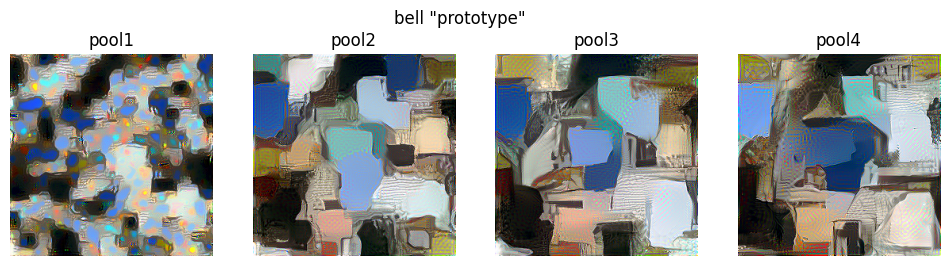

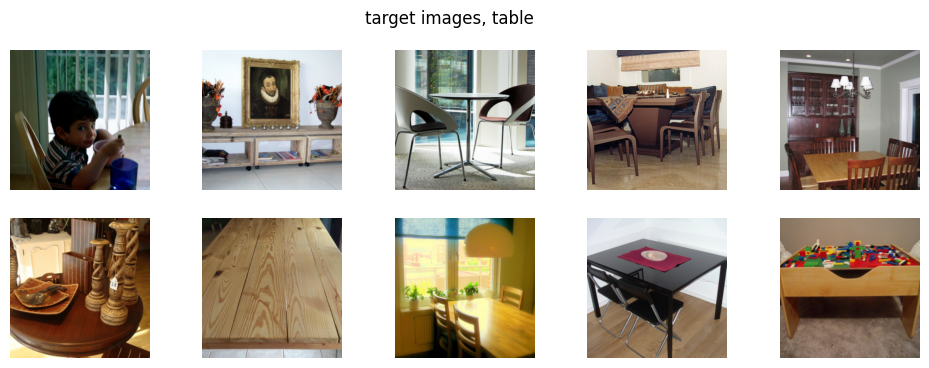

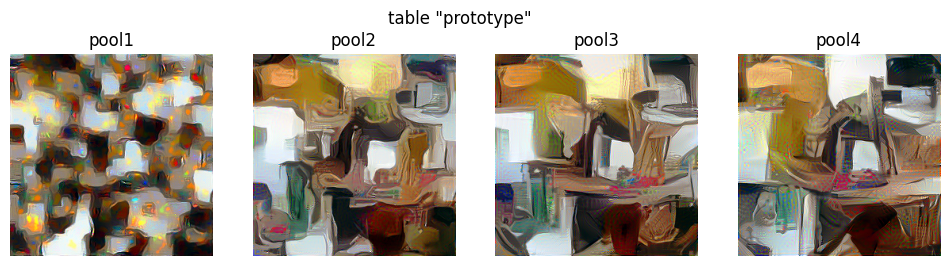

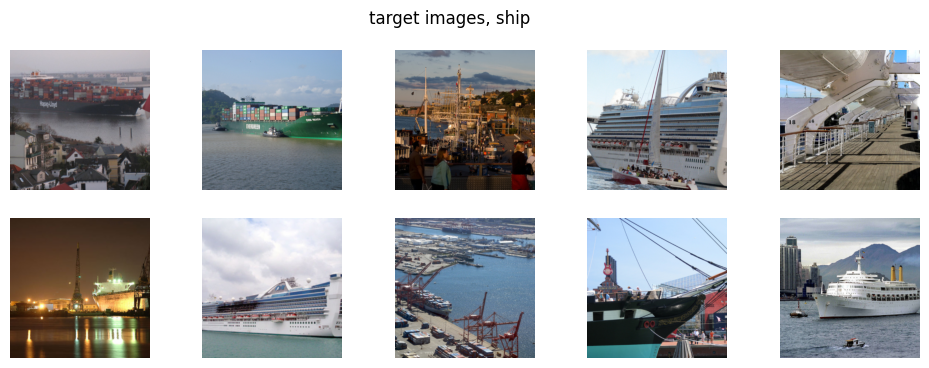

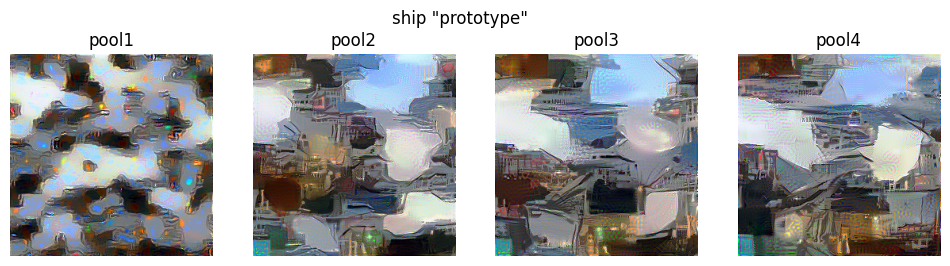

In [16]:
stim_path = '/user_data/mmhender/stimuli/featsynth/images_v2_basic_prototypes'

n_ims_combine = 10

for bi in np.arange(0,64,8):
    
    bname = basic_names[bi]
    
    # choose images to analyze here
    folder = os.path.join(ecoset_path, 'train', info['binfo'][bname]['ecoset_folder'])
    imfiles_all = efiles[bname]['train']['images']
    sizes = efiles[bname]['train']['size']
    abv_thresh = np.array([(s1>=pix_thresh) & (s2>=pix_thresh) for s1, s2 in sizes])
    is_rgb = np.array(efiles[bname]['train']['mode'])=='RGB'
    ims_use_all = np.where(abv_thresh & is_rgb)[0]

    np.random.seed(867878+bi)
    ims_use = np.random.choice(ims_use_all, n_ims_combine, replace=False)
    
    target_image_filenames = [os.path.join(folder, imfiles_all[im]) for im in ims_use]


    plt.figure(figsize=(12,4))

    for ii, im in enumerate(ims_use):

        target_image_filename = os.path.join(folder, imfiles_all[im])

        im = utilities.preprocess_image_tosave(
                utilities.load_image(target_image_filename)
            )
        # im = PIL.Image.open(target_image_filename)

        plt.subplot(2, 5, ii+1)

        plt.imshow(im)
        plt.axis('off')

    plt.suptitle('target images, %s'%(bname));

    plt.figure(figsize=(12,3))

    out_dir = os.path.join(stim_path, '%s_prototype_%dims'%(bname, n_ims_combine))
    layers_plot = ['pool1','pool2','pool3','pool4']

    for ll in range(4):

        plt.subplot(1,4,ll+1)
        fn = os.path.join(out_dir, 'scramble_upto_%s.png'%(layers_plot[ll]))
        im = PIL.Image.open(fn)
        plt.imshow(im)
        plt.axis('off')
        plt.title('%s'%(layers_plot[ll]))

    plt.suptitle('%s "prototype"'%(bname));